In [304]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

pd.set_option('display.max_rows', None)

In [241]:
df_raw = pd.read_csv("data/apple_health_export_2025-11-22.csv")

/var/folders/n5/vq6xltkj6nbfjvktp9d79y0h0000gn/T/ipykernel_53778/3824986607.py:1: DtypeWarning: Columns (0,1,2,3,4,5,6,9,10,13,14,16,19,22,27,28,29,30,31,33,34,36) have mixed types. Specify dtype option on import or set low_memory=False.
  df_raw = pd.read_csv("data/apple_health_export_2025-11-22.csv")


In [242]:
df_raw.head()

,type,sourceName,value,unit,startDate,endDate,creationDate,appleStandHours,appleExerciseTimeGoal,FitzpatrickSkinType,...,path,BloodType,device,date,key,activeEnergyBurned,dateComponents,BiologicalSex,sum,time
0,MenstrualFlow,Cycle Tracking,HKCategoryValueVaginalBleedingUnspecified,NaN,2025-11-19 12:00:00 +0100,2025-11-19 12:00:00 +0100,2025-11-19 08:45:07 +0100,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,HeartRate,Yichen的Apple Watch,69,count/min,2025-11-19 10:10:23 +0100,2025-11-19 10:10:23 +0100,2025-11-19 10:13:52 +0100,NaN,NaN,NaN,...,NaN,NaN,"<<HKDevice: 0x710e96fd0>, name:Apple Watch, ma...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,HeartRate,Yichen的Apple Watch,66,count/min,2025-11-19 10:05:05 +0100,2025-11-19 10:05:05 +0100,2025-11-19 10:12:26 +0100,NaN,NaN,NaN,...,NaN,NaN,"<<HKDevice: 0x710e96fd0>, name:Apple Watch, ma...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,ActiveEnergyBurned,Yichen的Apple Watch,0.363,kcal,2025-11-19 10:02:39 +0100,2025-11-19 10:04:21 +0100,2025-11-19 10:05:13 +0100,NaN,NaN,NaN,...,NaN,NaN,"<<HKDevice: 0x710ad6530>, name:Apple Watch, ma...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,HeartRate,Yichen的Apple Watch,68,count/min,2025-11-19 09:58:16 +0100,2025-11-19 09:58:16 +0100,2025-11-19 10:05:13 +0100,NaN,NaN,NaN,...,NaN,NaN,"<<HKDevice: 0x710e96fd0>, name:Apple Watch, ma...",NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [243]:
df_raw["type"].unique()

array(['MenstrualFlow', 'HeartRate', 'ActiveEnergyBurned',
       'BasalEnergyBurned', 'StepCount', 'DistanceWalkingRunning',
       'PhysicalEffort', 'EnvironmentalAudioExposure', 'AppleStandTime',
       'HeartRateVariabilitySDNN', 'AppleStandHour', 'AppleExerciseTime',
       'WalkingStepLength', 'WalkingDoubleSupportPercentage',
       'WalkingSpeed', 'StairAscentSpeed', 'FlightsClimbed',
       'WalkingAsymmetryPercentage', 'StairDescentSpeed',
       'RespiratoryRate', 'SleepAnalysis', 'RestingHeartRate', 'VO2Max',
       'RunningPower', 'RunningSpeed', 'RunningVerticalOscillation',
       'RunningGroundContactTime', 'RunningStrideLength', nan,
       'WalkingHeartRateAverage', 'HeadphoneAudioExposure',
       'AudioExposureEvent', 'HeartRateRecoveryOneMinute', 'Fatigue',
       'SixMinuteWalkTestDistance', 'AppleWalkingSteadiness',
       'MindfulSession', 'MoodChanges', 'BreastPain', 'Diarrhea',
       'HKDataTypeSleepDurationGoal', 'AbdominalCramps', 'Headache',
       'Chills

In [244]:
df_raw["startDate"] = pd.to_datetime(df_raw["startDate"])
df_raw["endDate"] = pd.to_datetime(df_raw["endDate"])

In [245]:
df_raw["sourceName"].unique()

array(['Cycle Tracking', 'Yichen的Apple\xa0Watch', 'Yichen’s Phone (2)',
       'Pillow', 'AutoSleep', nan, 'Health', 'Yichen的 iPad (2)', 'Sleep',
       'Zepp Life', 'Keep', '香山 Health', 'Clock'], dtype=object)

In [246]:
df_raw = df_raw[df_raw["sourceName"].str.contains("Watch", na=False)]
df_raw.head()

,type,sourceName,value,unit,startDate,endDate,creationDate,appleStandHours,appleExerciseTimeGoal,FitzpatrickSkinType,...,path,BloodType,device,date,key,activeEnergyBurned,dateComponents,BiologicalSex,sum,time
1,HeartRate,Yichen的Apple Watch,69,count/min,2025-11-19 10:10:23+01:00,2025-11-19 10:10:23+01:00,2025-11-19 10:13:52 +0100,NaN,NaN,NaN,...,NaN,NaN,"<<HKDevice: 0x710e96fd0>, name:Apple Watch, ma...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,HeartRate,Yichen的Apple Watch,66,count/min,2025-11-19 10:05:05+01:00,2025-11-19 10:05:05+01:00,2025-11-19 10:12:26 +0100,NaN,NaN,NaN,...,NaN,NaN,"<<HKDevice: 0x710e96fd0>, name:Apple Watch, ma...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,ActiveEnergyBurned,Yichen的Apple Watch,0.363,kcal,2025-11-19 10:02:39+01:00,2025-11-19 10:04:21+01:00,2025-11-19 10:05:13 +0100,NaN,NaN,NaN,...,NaN,NaN,"<<HKDevice: 0x710ad6530>, name:Apple Watch, ma...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,HeartRate,Yichen的Apple Watch,68,count/min,2025-11-19 09:58:16+01:00,2025-11-19 09:58:16+01:00,2025-11-19 10:05:13 +0100,NaN,NaN,NaN,...,NaN,NaN,"<<HKDevice: 0x710e96fd0>, name:Apple Watch, ma...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,HeartRate,Yichen的Apple Watch,69,count/min,2025-11-19 09:55:06+01:00,2025-11-19 09:55:06+01:00,2025-11-19 09:59:38 +0100,NaN,NaN,NaN,...,NaN,NaN,"<<HKDevice: 0x710e96fd0>, name:Apple Watch, ma...",NaN,NaN,NaN,NaN,NaN,NaN,NaN


## Sleep

In [247]:
df_sleep = df_raw[df_raw["type"] == "SleepAnalysis"]
# df_sleep = df_sleep[["value", "startDate", "endDate"]]
df_sleep

,type,sourceName,value,unit,startDate,endDate,creationDate,appleStandHours,appleExerciseTimeGoal,FitzpatrickSkinType,...,path,BloodType,device,date,key,activeEnergyBurned,dateComponents,BiologicalSex,sum,time
365,SleepAnalysis,Yichen的Apple Watch,HKCategoryValueSleepAnalysisInBed,NaN,2025-11-19 06:50:57+01:00,2025-11-19 07:02:27+01:00,2025-11-19 07:16:44 +0100,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
366,SleepAnalysis,Yichen的Apple Watch,HKCategoryValueSleepAnalysisAsleepCore,NaN,2025-11-19 06:50:57+01:00,2025-11-19 07:02:27+01:00,2025-11-19 07:16:44 +0100,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
372,SleepAnalysis,Yichen的Apple Watch,HKCategoryValueSleepAnalysisAwake,NaN,2025-11-19 06:42:57+01:00,2025-11-19 06:50:57+01:00,2025-11-19 07:16:44 +0100,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
384,SleepAnalysis,Yichen的Apple Watch,HKCategoryValueSleepAnalysisInBed,NaN,2025-11-19 06:28:57+01:00,2025-11-19 06:42:57+01:00,2025-11-19 07:16:44 +0100,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
385,SleepAnalysis,Yichen的Apple Watch,HKCategoryValueSleepAnalysisAsleepCore,NaN,2025-11-19 06:28:57+01:00,2025-11-19 06:42:57+01:00,2025-11-19 07:16:44 +0100,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
387,SleepAnalysis,Yichen的Apple Watch,HKCategoryValueSleepAnalysisAwake,NaN,2025-11-19 06:27:57+01:00,2025-11-19 06:28:57+01:00,2025-11-19 07:16:44 +0100,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
397,SleepAnalysis,Yichen的Apple Watch,HKCategoryValueSleepAnalysisAsleepREM,NaN,2025-11-19 06:13:27+01:00,2025-11-19 06:27:57+01:00,2025-11-19 07:16:44 +0100,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
427,SleepAnalysis,Yichen的Apple Watch,HKCategoryValueSleepAnalysisAsleepCore,NaN,2025-11-19 05:15:57+01:00,2025-11-19 06:13:27+01:00,2025-11-19 07:16:44 +0100,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
440,SleepAnalysis,Yichen的Apple Watch,HKCategoryValueSleepAnalysisAsleepREM,NaN,2025-11-19 04:54:27+01:00,2025-11-19 05:15:57+01:00,2025-11-19 07:16:44 +0100,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
483,SleepAnalysis,Yichen的Apple Watch,HKCategoryValueSleepAnalysisAsleepCore,NaN,2025-11-19 03:40:57+01:00,2025-11-19 04:54:27+01:00,2025-11-19 07:16:44 +0100,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### Code sleep datum

In [248]:
def get_sleep_day(start):
    # if sleep segment starts in the evening, count it for the next day
    if start.hour >= 18:
        return (start + pd.Timedelta(days=1)).date()
    else:
        return start.date()

In [249]:
df_sleep["sleep_day"] = df_sleep["startDate"].apply(get_sleep_day)

/var/folders/n5/vq6xltkj6nbfjvktp9d79y0h0000gn/T/ipykernel_53778/1870435275.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_sleep["sleep_day"] = df_sleep["startDate"].apply(get_sleep_day)


In [250]:
df_sleep.head()

,type,sourceName,value,unit,startDate,endDate,creationDate,appleStandHours,appleExerciseTimeGoal,FitzpatrickSkinType,...,BloodType,device,date,key,activeEnergyBurned,dateComponents,BiologicalSex,sum,time,sleep_day
365,SleepAnalysis,Yichen的Apple Watch,HKCategoryValueSleepAnalysisInBed,NaN,2025-11-19 06:50:57+01:00,2025-11-19 07:02:27+01:00,2025-11-19 07:16:44 +0100,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2025-11-19
366,SleepAnalysis,Yichen的Apple Watch,HKCategoryValueSleepAnalysisAsleepCore,NaN,2025-11-19 06:50:57+01:00,2025-11-19 07:02:27+01:00,2025-11-19 07:16:44 +0100,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2025-11-19
372,SleepAnalysis,Yichen的Apple Watch,HKCategoryValueSleepAnalysisAwake,NaN,2025-11-19 06:42:57+01:00,2025-11-19 06:50:57+01:00,2025-11-19 07:16:44 +0100,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2025-11-19
384,SleepAnalysis,Yichen的Apple Watch,HKCategoryValueSleepAnalysisInBed,NaN,2025-11-19 06:28:57+01:00,2025-11-19 06:42:57+01:00,2025-11-19 07:16:44 +0100,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2025-11-19
385,SleepAnalysis,Yichen的Apple Watch,HKCategoryValueSleepAnalysisAsleepCore,NaN,2025-11-19 06:28:57+01:00,2025-11-19 06:42:57+01:00,2025-11-19 07:16:44 +0100,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2025-11-19


### Select von 20 Uhr bis 12 Uhr als sleep

In [251]:
sleep_not_night = df_sleep[(df_sleep["startDate"].dt.hour < 20) & (df_sleep["startDate"].dt.hour > 12)]

In [252]:
df_sleep = df_sleep[(df_sleep["startDate"].dt.hour > 20) | (df_sleep["startDate"].dt.hour < 12) ]

### Sleep duration berechnen

In [253]:
# compute duration in minutes
df_sleep["duration"] = (df_sleep["endDate"] - df_sleep["startDate"])#.dt.total_seconds()
#df_sleep["duration_min"] = df_sleep["duration_sec"] / 60

/var/folders/n5/vq6xltkj6nbfjvktp9d79y0h0000gn/T/ipykernel_53778/4109660549.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_sleep["duration"] = (df_sleep["endDate"] - df_sleep["startDate"])#.dt.total_seconds()


In [254]:
df_sleep.head()

,type,sourceName,value,unit,startDate,endDate,creationDate,appleStandHours,appleExerciseTimeGoal,FitzpatrickSkinType,...,BloodType,device,date,key,activeEnergyBurned,dateComponents,BiologicalSex,sum,time,sleep_day
365,SleepAnalysis,Yichen的Apple Watch,HKCategoryValueSleepAnalysisInBed,NaN,2025-11-19 06:50:57+01:00,2025-11-19 07:02:27+01:00,2025-11-19 07:16:44 +0100,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2025-11-19
366,SleepAnalysis,Yichen的Apple Watch,HKCategoryValueSleepAnalysisAsleepCore,NaN,2025-11-19 06:50:57+01:00,2025-11-19 07:02:27+01:00,2025-11-19 07:16:44 +0100,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2025-11-19
372,SleepAnalysis,Yichen的Apple Watch,HKCategoryValueSleepAnalysisAwake,NaN,2025-11-19 06:42:57+01:00,2025-11-19 06:50:57+01:00,2025-11-19 07:16:44 +0100,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2025-11-19
384,SleepAnalysis,Yichen的Apple Watch,HKCategoryValueSleepAnalysisInBed,NaN,2025-11-19 06:28:57+01:00,2025-11-19 06:42:57+01:00,2025-11-19 07:16:44 +0100,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2025-11-19
385,SleepAnalysis,Yichen的Apple Watch,HKCategoryValueSleepAnalysisAsleepCore,NaN,2025-11-19 06:28:57+01:00,2025-11-19 06:42:57+01:00,2025-11-19 07:16:44 +0100,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2025-11-19


In [255]:
sleep_grouped = df_sleep.groupby(["sleep_day", "value"])["duration"].sum().reset_index()
sleep_grouped

,sleep_day,value,duration
0,2022-07-23,HKCategoryValueSleepAnalysisAsleepUnspecified,0 days 07:18:30
1,2022-07-24,HKCategoryValueSleepAnalysisAsleepUnspecified,0 days 07:33:00
2,2022-07-25,HKCategoryValueSleepAnalysisAsleepUnspecified,0 days 07:34:00
3,2022-07-26,HKCategoryValueSleepAnalysisAsleepUnspecified,0 days 07:22:30
4,2022-07-27,HKCategoryValueSleepAnalysisAsleepUnspecified,0 days 07:39:00
5,2022-07-28,HKCategoryValueSleepAnalysisAsleepUnspecified,0 days 07:33:00
6,2022-07-29,HKCategoryValueSleepAnalysisAsleepUnspecified,0 days 07:18:00
7,2022-07-30,HKCategoryValueSleepAnalysisAsleepUnspecified,0 days 08:35:30
8,2022-07-31,HKCategoryValueSleepAnalysisAsleepUnspecified,0 days 07:08:30
9,2022-08-01,HKCategoryValueSleepAnalysisAsleepUnspecified,0 days 07:44:00


In [256]:
sleep_agg = sleep_grouped.pivot(
    index="sleep_day",
    columns="value",
    values="duration"
).fillna(0)
sleep_agg

value,HKCategoryValueSleepAnalysisAsleepCore,HKCategoryValueSleepAnalysisAsleepDeep,HKCategoryValueSleepAnalysisAsleepREM,HKCategoryValueSleepAnalysisAsleepUnspecified,HKCategoryValueSleepAnalysisAwake,HKCategoryValueSleepAnalysisInBed
sleep_day,,,,,,
2022-07-23,0,0,0,0 days 07:18:30,0,0
2022-07-24,0,0,0,0 days 07:33:00,0,0
2022-07-25,0,0,0,0 days 07:34:00,0,0
2022-07-26,0,0,0,0 days 07:22:30,0,0
2022-07-27,0,0,0,0 days 07:39:00,0,0
2022-07-28,0,0,0,0 days 07:33:00,0,0
2022-07-29,0,0,0,0 days 07:18:00,0,0
2022-07-30,0,0,0,0 days 08:35:30,0,0
2022-07-31,0,0,0,0 days 07:08:30,0,0


In [257]:
for col in [
    "HKCategoryValueSleepAnalysisAsleepCore",
    "HKCategoryValueSleepAnalysisAsleepDeep",
    "HKCategoryValueSleepAnalysisAsleepREM",
    "HKCategoryValueSleepAnalysisAwake",
    'HKCategoryValueSleepAnalysisAsleepUnspecified'
]:
    sleep_agg[col] = pd.to_timedelta(sleep_agg[col])


In [258]:
sleep_agg.columns

Index(['HKCategoryValueSleepAnalysisAsleepCore',
       'HKCategoryValueSleepAnalysisAsleepDeep',
       'HKCategoryValueSleepAnalysisAsleepREM',
       'HKCategoryValueSleepAnalysisAsleepUnspecified',
       'HKCategoryValueSleepAnalysisAwake',
       'HKCategoryValueSleepAnalysisInBed'],
      dtype='object', name='value')

In [259]:
sleep_agg["sleep_duration_sum"] = sleep_agg["HKCategoryValueSleepAnalysisAsleepCore"] + sleep_agg["HKCategoryValueSleepAnalysisAsleepDeep"] + sleep_agg["HKCategoryValueSleepAnalysisAsleepREM"] + sleep_agg["HKCategoryValueSleepAnalysisAwake"] + sleep_agg['HKCategoryValueSleepAnalysisAsleepUnspecified']
sleep_agg.head()

value,HKCategoryValueSleepAnalysisAsleepCore,HKCategoryValueSleepAnalysisAsleepDeep,HKCategoryValueSleepAnalysisAsleepREM,HKCategoryValueSleepAnalysisAsleepUnspecified,HKCategoryValueSleepAnalysisAwake,HKCategoryValueSleepAnalysisInBed,sleep_duration_sum
sleep_day,,,,,,,
2022-07-23,0 days,0 days,0 days,0 days 07:18:30,0 days,0,0 days 07:18:30
2022-07-24,0 days,0 days,0 days,0 days 07:33:00,0 days,0,0 days 07:33:00
2022-07-25,0 days,0 days,0 days,0 days 07:34:00,0 days,0,0 days 07:34:00
2022-07-26,0 days,0 days,0 days,0 days 07:22:30,0 days,0,0 days 07:22:30
2022-07-27,0 days,0 days,0 days,0 days 07:39:00,0 days,0,0 days 07:39:00


In [260]:
sleep_agg["duration_min"] = sleep_agg["sleep_duration_sum"] / pd.Timedelta(minutes=1)
sleep_agg.head()

value,HKCategoryValueSleepAnalysisAsleepCore,HKCategoryValueSleepAnalysisAsleepDeep,HKCategoryValueSleepAnalysisAsleepREM,HKCategoryValueSleepAnalysisAsleepUnspecified,HKCategoryValueSleepAnalysisAwake,HKCategoryValueSleepAnalysisInBed,sleep_duration_sum,duration_min
sleep_day,,,,,,,,
2022-07-23,0 days,0 days,0 days,0 days 07:18:30,0 days,0,0 days 07:18:30,438.5
2022-07-24,0 days,0 days,0 days,0 days 07:33:00,0 days,0,0 days 07:33:00,453.0
2022-07-25,0 days,0 days,0 days,0 days 07:34:00,0 days,0,0 days 07:34:00,454.0
2022-07-26,0 days,0 days,0 days,0 days 07:22:30,0 days,0,0 days 07:22:30,442.5
2022-07-27,0 days,0 days,0 days,0 days 07:39:00,0 days,0,0 days 07:39:00,459.0


In [261]:
sleep_agg

value,HKCategoryValueSleepAnalysisAsleepCore,HKCategoryValueSleepAnalysisAsleepDeep,HKCategoryValueSleepAnalysisAsleepREM,HKCategoryValueSleepAnalysisAsleepUnspecified,HKCategoryValueSleepAnalysisAwake,HKCategoryValueSleepAnalysisInBed,sleep_duration_sum,duration_min
sleep_day,,,,,,,,
2022-07-23,0 days 00:00:00,0 days 00:00:00,0 days 00:00:00,0 days 07:18:30,0 days 00:00:00,0,0 days 07:18:30,438.5
2022-07-24,0 days 00:00:00,0 days 00:00:00,0 days 00:00:00,0 days 07:33:00,0 days 00:00:00,0,0 days 07:33:00,453.0
2022-07-25,0 days 00:00:00,0 days 00:00:00,0 days 00:00:00,0 days 07:34:00,0 days 00:00:00,0,0 days 07:34:00,454.0
2022-07-26,0 days 00:00:00,0 days 00:00:00,0 days 00:00:00,0 days 07:22:30,0 days 00:00:00,0,0 days 07:22:30,442.5
2022-07-27,0 days 00:00:00,0 days 00:00:00,0 days 00:00:00,0 days 07:39:00,0 days 00:00:00,0,0 days 07:39:00,459.0
2022-07-28,0 days 00:00:00,0 days 00:00:00,0 days 00:00:00,0 days 07:33:00,0 days 00:00:00,0,0 days 07:33:00,453.0
2022-07-29,0 days 00:00:00,0 days 00:00:00,0 days 00:00:00,0 days 07:18:00,0 days 00:00:00,0,0 days 07:18:00,438.0
2022-07-30,0 days 00:00:00,0 days 00:00:00,0 days 00:00:00,0 days 08:35:30,0 days 00:00:00,0,0 days 08:35:30,515.5
2022-07-31,0 days 00:00:00,0 days 00:00:00,0 days 00:00:00,0 days 07:08:30,0 days 00:00:00,0,0 days 07:08:30,428.5


In [262]:
sleep_agg[sleep_agg["duration_min"] < 120]

value,HKCategoryValueSleepAnalysisAsleepCore,HKCategoryValueSleepAnalysisAsleepDeep,HKCategoryValueSleepAnalysisAsleepREM,HKCategoryValueSleepAnalysisAsleepUnspecified,HKCategoryValueSleepAnalysisAwake,HKCategoryValueSleepAnalysisInBed,sleep_duration_sum,duration_min
sleep_day,,,,,,,,
2025-09-03,0 days 00:34:30,0 days 00:08:30,0 days 00:10:30,0 days,0 days 00:05:00,0 days 00:16:30,0 days 00:58:30,58.5


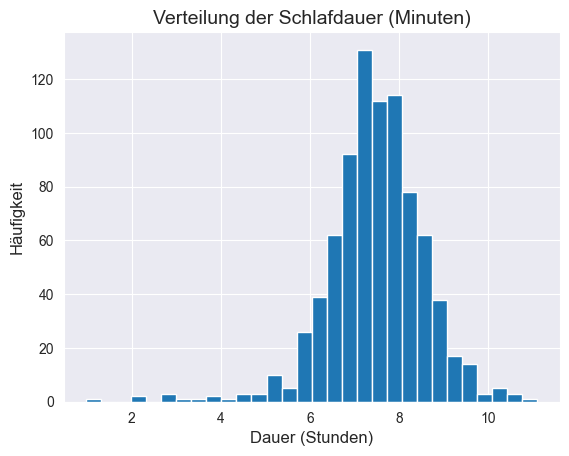

In [263]:
plt.hist(sleep_agg["duration_min"] / 60, bins=30)
plt.title("Verteilung der Schlafdauer (Minuten)", fontsize=14)
plt.xlabel("Dauer (Stunden)", fontsize=12)
plt.ylabel("Häufigkeit", fontsize=12)
plt.show()

## HRV

In [264]:
df_hrv = df_raw[df_raw["type"] == "HeartRateVariabilitySDNN"]
df_hrv.head()

,type,sourceName,value,unit,startDate,endDate,creationDate,appleStandHours,appleExerciseTimeGoal,FitzpatrickSkinType,...,path,BloodType,device,date,key,activeEnergyBurned,dateComponents,BiologicalSex,sum,time
38,HeartRateVariabilitySDNN,Yichen的Apple Watch,21.1657,ms,2025-11-19 09:09:35+01:00,2025-11-19 09:10:34+01:00,2025-11-19 09:10:36 +0100,NaN,NaN,NaN,...,NaN,NaN,"<<HKDevice: 0x710a9e530>, name:Apple Watch, ma...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
371,HeartRateVariabilitySDNN,Yichen的Apple Watch,55.3567,ms,2025-11-19 06:43:58+01:00,2025-11-19 06:44:58+01:00,2025-11-19 06:44:59 +0100,NaN,NaN,NaN,...,NaN,NaN,"<<HKDevice: 0x710a9e530>, name:Apple Watch, ma...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
449,HeartRateVariabilitySDNN,Yichen的Apple Watch,110.33,ms,2025-11-19 04:42:44+01:00,2025-11-19 04:43:43+01:00,2025-11-19 04:43:45 +0100,NaN,NaN,NaN,...,NaN,NaN,"<<HKDevice: 0x710a9e530>, name:Apple Watch, ma...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
519,HeartRateVariabilitySDNN,Yichen的Apple Watch,30.4737,ms,2025-11-19 02:42:44+01:00,2025-11-19 02:43:43+01:00,2025-11-19 02:43:45 +0100,NaN,NaN,NaN,...,NaN,NaN,"<<HKDevice: 0x710a9e530>, name:Apple Watch, ma...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
584,HeartRateVariabilitySDNN,Yichen的Apple Watch,36.0952,ms,2025-11-19 00:55:38+01:00,2025-11-19 00:56:38+01:00,2025-11-19 00:56:40 +0100,NaN,NaN,NaN,...,NaN,NaN,"<<HKDevice: 0x710a9e530>, name:Apple Watch, ma...",NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [265]:
def get_hrv_day(end):
        return end.date()

In [266]:
df_hrv["hrv_day"] = df_hrv["endDate"].apply(get_hrv_day)

/var/folders/n5/vq6xltkj6nbfjvktp9d79y0h0000gn/T/ipykernel_53778/2445452695.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_hrv["hrv_day"] = df_hrv["endDate"].apply(get_hrv_day)


In [267]:
df_hrv.head()

,type,sourceName,value,unit,startDate,endDate,creationDate,appleStandHours,appleExerciseTimeGoal,FitzpatrickSkinType,...,BloodType,device,date,key,activeEnergyBurned,dateComponents,BiologicalSex,sum,time,hrv_day
38,HeartRateVariabilitySDNN,Yichen的Apple Watch,21.1657,ms,2025-11-19 09:09:35+01:00,2025-11-19 09:10:34+01:00,2025-11-19 09:10:36 +0100,NaN,NaN,NaN,...,NaN,"<<HKDevice: 0x710a9e530>, name:Apple Watch, ma...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,2025-11-19
371,HeartRateVariabilitySDNN,Yichen的Apple Watch,55.3567,ms,2025-11-19 06:43:58+01:00,2025-11-19 06:44:58+01:00,2025-11-19 06:44:59 +0100,NaN,NaN,NaN,...,NaN,"<<HKDevice: 0x710a9e530>, name:Apple Watch, ma...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,2025-11-19
449,HeartRateVariabilitySDNN,Yichen的Apple Watch,110.33,ms,2025-11-19 04:42:44+01:00,2025-11-19 04:43:43+01:00,2025-11-19 04:43:45 +0100,NaN,NaN,NaN,...,NaN,"<<HKDevice: 0x710a9e530>, name:Apple Watch, ma...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,2025-11-19
519,HeartRateVariabilitySDNN,Yichen的Apple Watch,30.4737,ms,2025-11-19 02:42:44+01:00,2025-11-19 02:43:43+01:00,2025-11-19 02:43:45 +0100,NaN,NaN,NaN,...,NaN,"<<HKDevice: 0x710a9e530>, name:Apple Watch, ma...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,2025-11-19
584,HeartRateVariabilitySDNN,Yichen的Apple Watch,36.0952,ms,2025-11-19 00:55:38+01:00,2025-11-19 00:56:38+01:00,2025-11-19 00:56:40 +0100,NaN,NaN,NaN,...,NaN,"<<HKDevice: 0x710a9e530>, name:Apple Watch, ma...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,2025-11-19


In [268]:
df_hrv["value"] = pd.to_numeric(df_hrv["value"], errors="coerce")

/var/folders/n5/vq6xltkj6nbfjvktp9d79y0h0000gn/T/ipykernel_53778/793133307.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_hrv["value"] = pd.to_numeric(df_hrv["value"], errors="coerce")


In [269]:
df_hrv.head()

,type,sourceName,value,unit,startDate,endDate,creationDate,appleStandHours,appleExerciseTimeGoal,FitzpatrickSkinType,...,BloodType,device,date,key,activeEnergyBurned,dateComponents,BiologicalSex,sum,time,hrv_day
38,HeartRateVariabilitySDNN,Yichen的Apple Watch,21.1657,ms,2025-11-19 09:09:35+01:00,2025-11-19 09:10:34+01:00,2025-11-19 09:10:36 +0100,NaN,NaN,NaN,...,NaN,"<<HKDevice: 0x710a9e530>, name:Apple Watch, ma...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,2025-11-19
371,HeartRateVariabilitySDNN,Yichen的Apple Watch,55.3567,ms,2025-11-19 06:43:58+01:00,2025-11-19 06:44:58+01:00,2025-11-19 06:44:59 +0100,NaN,NaN,NaN,...,NaN,"<<HKDevice: 0x710a9e530>, name:Apple Watch, ma...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,2025-11-19
449,HeartRateVariabilitySDNN,Yichen的Apple Watch,110.3300,ms,2025-11-19 04:42:44+01:00,2025-11-19 04:43:43+01:00,2025-11-19 04:43:45 +0100,NaN,NaN,NaN,...,NaN,"<<HKDevice: 0x710a9e530>, name:Apple Watch, ma...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,2025-11-19
519,HeartRateVariabilitySDNN,Yichen的Apple Watch,30.4737,ms,2025-11-19 02:42:44+01:00,2025-11-19 02:43:43+01:00,2025-11-19 02:43:45 +0100,NaN,NaN,NaN,...,NaN,"<<HKDevice: 0x710a9e530>, name:Apple Watch, ma...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,2025-11-19
584,HeartRateVariabilitySDNN,Yichen的Apple Watch,36.0952,ms,2025-11-19 00:55:38+01:00,2025-11-19 00:56:38+01:00,2025-11-19 00:56:40 +0100,NaN,NaN,NaN,...,NaN,"<<HKDevice: 0x710a9e530>, name:Apple Watch, ma...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,2025-11-19


In [270]:
hrv_agg = df_hrv.groupby(["hrv_day"])["value"].mean().reset_index()
hrv_agg.head()

,hrv_day,value
0,2022-07-22,31.076133
1,2022-07-23,39.513417
2,2022-07-24,44.292517
3,2022-07-25,34.085320
4,2022-07-26,58.217429


In [271]:
hrv_agg = hrv_agg.rename(columns={"value": "mean_hrv"})

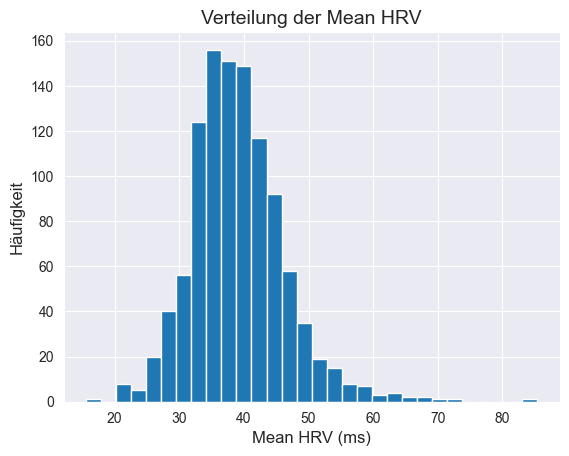

In [272]:
plt.hist(hrv_agg["mean_hrv"], bins=30)
plt.title("Verteilung der Mean HRV", fontsize=14)
plt.xlabel("Mean HRV (ms)", fontsize=12)
plt.ylabel("Häufigkeit", fontsize=12)
plt.show()

## Merge Sleep und HRV Data

In [273]:
df_all = pd.merge(sleep_agg, hrv_agg, left_on="sleep_day", right_on="hrv_day", how="left")

In [274]:
df_all.head()

,HKCategoryValueSleepAnalysisAsleepCore,HKCategoryValueSleepAnalysisAsleepDeep,HKCategoryValueSleepAnalysisAsleepREM,HKCategoryValueSleepAnalysisAsleepUnspecified,HKCategoryValueSleepAnalysisAwake,HKCategoryValueSleepAnalysisInBed,sleep_duration_sum,duration_min,hrv_day,mean_hrv
0,0 days,0 days,0 days,0 days 07:18:30,0 days,0,0 days 07:18:30,438.5,2022-07-23,39.513417
1,0 days,0 days,0 days,0 days 07:33:00,0 days,0,0 days 07:33:00,453.0,2022-07-24,44.292517
2,0 days,0 days,0 days,0 days 07:34:00,0 days,0,0 days 07:34:00,454.0,2022-07-25,34.085320
3,0 days,0 days,0 days,0 days 07:22:30,0 days,0,0 days 07:22:30,442.5,2022-07-26,58.217429
4,0 days,0 days,0 days,0 days 07:39:00,0 days,0,0 days 07:39:00,459.0,2022-07-27,27.340533


## Data Cleaning

### rename columns

In [275]:
df_all.columns

Index(['HKCategoryValueSleepAnalysisAsleepCore',
       'HKCategoryValueSleepAnalysisAsleepDeep',
       'HKCategoryValueSleepAnalysisAsleepREM',
       'HKCategoryValueSleepAnalysisAsleepUnspecified',
       'HKCategoryValueSleepAnalysisAwake',
       'HKCategoryValueSleepAnalysisInBed', 'sleep_duration_sum',
       'duration_min', 'hrv_day', 'mean_hrv'],
      dtype='object')

In [276]:
df_all.columns = df_all.columns.str.replace("HKCategoryValueSleepAnalysis", "", regex=False)
df_all.head()

,AsleepCore,AsleepDeep,AsleepREM,AsleepUnspecified,Awake,InBed,sleep_duration_sum,duration_min,hrv_day,mean_hrv
0,0 days,0 days,0 days,0 days 07:18:30,0 days,0,0 days 07:18:30,438.5,2022-07-23,39.513417
1,0 days,0 days,0 days,0 days 07:33:00,0 days,0,0 days 07:33:00,453.0,2022-07-24,44.292517
2,0 days,0 days,0 days,0 days 07:34:00,0 days,0,0 days 07:34:00,454.0,2022-07-25,34.085320
3,0 days,0 days,0 days,0 days 07:22:30,0 days,0,0 days 07:22:30,442.5,2022-07-26,58.217429
4,0 days,0 days,0 days,0 days 07:39:00,0 days,0,0 days 07:39:00,459.0,2022-07-27,27.340533


### Completeness checken

In [277]:
 df_incomplete = df_all[(df_all["AsleepCore"] == pd.Timedelta("0 days")) |
                        (df_all["AsleepDeep"] == pd.Timedelta("0 days")) |
                        (df_all["AsleepREM"] == pd.Timedelta("0 days"))]
 df_incomplete

,AsleepCore,AsleepDeep,AsleepREM,AsleepUnspecified,Awake,InBed,sleep_duration_sum,duration_min,hrv_day,mean_hrv
0,0 days 00:00:00,0 days,0 days 00:00:00,0 days 07:18:30,0 days 00:00:00,0,0 days 07:18:30,438.5,2022-07-23,39.513417
1,0 days 00:00:00,0 days,0 days 00:00:00,0 days 07:33:00,0 days 00:00:00,0,0 days 07:33:00,453.0,2022-07-24,44.292517
2,0 days 00:00:00,0 days,0 days 00:00:00,0 days 07:34:00,0 days 00:00:00,0,0 days 07:34:00,454.0,2022-07-25,34.085320
3,0 days 00:00:00,0 days,0 days 00:00:00,0 days 07:22:30,0 days 00:00:00,0,0 days 07:22:30,442.5,2022-07-26,58.217429
4,0 days 00:00:00,0 days,0 days 00:00:00,0 days 07:39:00,0 days 00:00:00,0,0 days 07:39:00,459.0,2022-07-27,27.340533
5,0 days 00:00:00,0 days,0 days 00:00:00,0 days 07:33:00,0 days 00:00:00,0,0 days 07:33:00,453.0,2022-07-28,34.528467
6,0 days 00:00:00,0 days,0 days 00:00:00,0 days 07:18:00,0 days 00:00:00,0,0 days 07:18:00,438.0,2022-07-29,42.778983
7,0 days 00:00:00,0 days,0 days 00:00:00,0 days 08:35:30,0 days 00:00:00,0,0 days 08:35:30,515.5,2022-07-30,47.258400
8,0 days 00:00:00,0 days,0 days 00:00:00,0 days 07:08:30,0 days 00:00:00,0,0 days 07:08:30,428.5,2022-07-31,41.408817
9,0 days 00:00:00,0 days,0 days 00:00:00,0 days 07:44:00,0 days 00:00:00,0,0 days 07:44:00,464.0,2022-08-01,37.349300


#### Delete Cells, AsleepCore, AsleepDeep, or AsleepREM equals 0

In [278]:
df_all = df_all[
    (df_all["AsleepCore"] != pd.Timedelta("0 days")) &
    (df_all["AsleepDeep"] != pd.Timedelta("0 days")) &
    (df_all["AsleepREM"] != pd.Timedelta("0 days"))
]

### na, null checken

In [279]:
# Identify missing values
df_all.isnull().sum()
df_all.isna().sum()

AsleepCore            0
AsleepDeep            0
AsleepREM             0
AsleepUnspecified     0
Awake                 0
InBed                 0
sleep_duration_sum    0
duration_min          0
hrv_day               0
mean_hrv              0
dtype: int64

### Duplicates

In [280]:
# Indentify Duplicates
df_all.duplicated().sum()

np.int64(0)

### Box plot

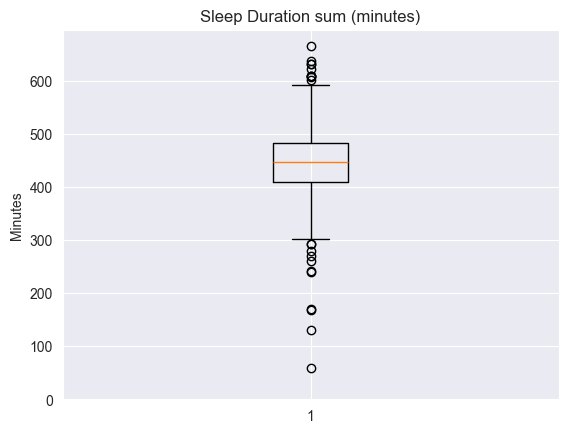

In [281]:
# Identify Outliers with box-plot
plt.boxplot(df_all["duration_min"])
plt.title("Sleep Duration sum (minutes)")
plt.ylabel("Minutes")
plt.ylim(bottom=0)
plt.show()

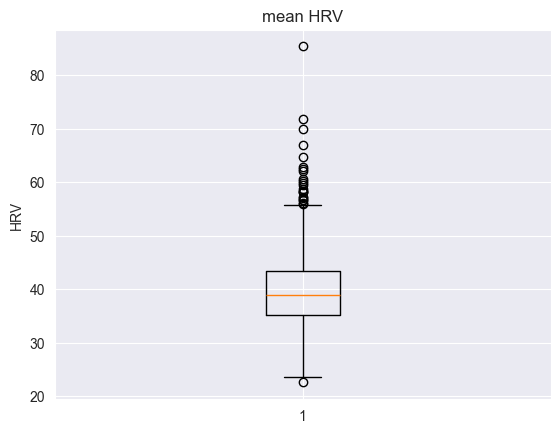

In [282]:
# Identify Outliers with box-plot
plt.boxplot(df_all["mean_hrv"])
plt.title("mean HRV")
plt.ylabel("HRV")
plt.show()

In [283]:
df_all

,AsleepCore,AsleepDeep,AsleepREM,AsleepUnspecified,Awake,InBed,sleep_duration_sum,duration_min,hrv_day,mean_hrv
60,0 days 03:42:00,0 days 01:13:00,0 days 01:41:30,0 days 00:00:00,0 days 00:01:30,0,0 days 06:38:00,398.0,2022-10-04,36.060950
61,0 days 04:51:00,0 days 00:53:30,0 days 01:49:30,0 days 00:00:00,0 days 00:03:00,0,0 days 07:37:00,457.0,2022-10-05,37.280973
62,0 days 03:46:30,0 days 01:16:00,0 days 01:48:00,0 days 00:00:00,0 days 00:10:00,0,0 days 07:00:30,420.5,2022-10-06,46.271080
63,0 days 06:43:00,0 days 00:44:30,0 days 02:27:30,0 days 00:00:00,0 days 00:26:30,0,0 days 10:21:30,621.5,2022-10-08,43.618358
64,0 days 06:11:30,0 days 00:36:30,0 days 02:06:30,0 days 00:00:00,0 days 00:07:00,0,0 days 09:01:30,541.5,2022-10-09,57.311775
65,0 days 05:41:00,0 days 00:35:00,0 days 02:17:30,0 days 00:00:00,0 days 00:05:30,0,0 days 08:39:00,519.0,2022-10-10,49.602583
66,0 days 05:27:30,0 days 00:47:00,0 days 01:41:30,0 days 00:00:00,0 days 00:04:30,0,0 days 08:00:30,480.5,2022-10-11,32.091150
67,0 days 06:15:30,0 days 01:01:30,0 days 02:19:30,0 days 00:00:00,0 days 00:02:30,0,0 days 09:39:00,579.0,2022-10-12,32.520627
68,0 days 05:06:00,0 days 00:42:00,0 days 01:49:30,0 days 00:00:00,0 days 00:03:30,0,0 days 07:41:00,461.0,2022-10-13,33.036936
69,0 days 05:35:30,0 days 01:00:30,0 days 01:58:30,0 days 00:00:00,0 days 00:14:30,0,0 days 08:49:00,529.0,2022-10-14,40.531091


In [ ]:
df_all.to_csv("df_all.csv", index=False")

## Calculate Sleep Index

### Calculate sleep Efficiency

In [286]:
df_all["sleep_efficiency"] = df_all["duration_min"] / (df_all["duration_min"] + (df_all["Awake"]/pd.Timedelta(minutes=1)))
df_all

,AsleepCore,AsleepDeep,AsleepREM,AsleepUnspecified,Awake,InBed,sleep_duration_sum,duration_min,hrv_day,mean_hrv,sleep_efficiency
60,0 days 03:42:00,0 days 01:13:00,0 days 01:41:30,0 days 00:00:00,0 days 00:01:30,0,0 days 06:38:00,398.0,2022-10-04,36.060950,0.996245
61,0 days 04:51:00,0 days 00:53:30,0 days 01:49:30,0 days 00:00:00,0 days 00:03:00,0,0 days 07:37:00,457.0,2022-10-05,37.280973,0.993478
62,0 days 03:46:30,0 days 01:16:00,0 days 01:48:00,0 days 00:00:00,0 days 00:10:00,0,0 days 07:00:30,420.5,2022-10-06,46.271080,0.976771
63,0 days 06:43:00,0 days 00:44:30,0 days 02:27:30,0 days 00:00:00,0 days 00:26:30,0,0 days 10:21:30,621.5,2022-10-08,43.618358,0.959105
64,0 days 06:11:30,0 days 00:36:30,0 days 02:06:30,0 days 00:00:00,0 days 00:07:00,0,0 days 09:01:30,541.5,2022-10-09,57.311775,0.987238
65,0 days 05:41:00,0 days 00:35:00,0 days 02:17:30,0 days 00:00:00,0 days 00:05:30,0,0 days 08:39:00,519.0,2022-10-10,49.602583,0.989514
66,0 days 05:27:30,0 days 00:47:00,0 days 01:41:30,0 days 00:00:00,0 days 00:04:30,0,0 days 08:00:30,480.5,2022-10-11,32.091150,0.990722
67,0 days 06:15:30,0 days 01:01:30,0 days 02:19:30,0 days 00:00:00,0 days 00:02:30,0,0 days 09:39:00,579.0,2022-10-12,32.520627,0.995701
68,0 days 05:06:00,0 days 00:42:00,0 days 01:49:30,0 days 00:00:00,0 days 00:03:30,0,0 days 07:41:00,461.0,2022-10-13,33.036936,0.992465
69,0 days 05:35:30,0 days 01:00:30,0 days 01:58:30,0 days 00:00:00,0 days 00:14:30,0,0 days 08:49:00,529.0,2022-10-14,40.531091,0.973321


# Visualizieren

## Matplotlib: Create basic plots (Histogram, Scatterplot, Subplots)

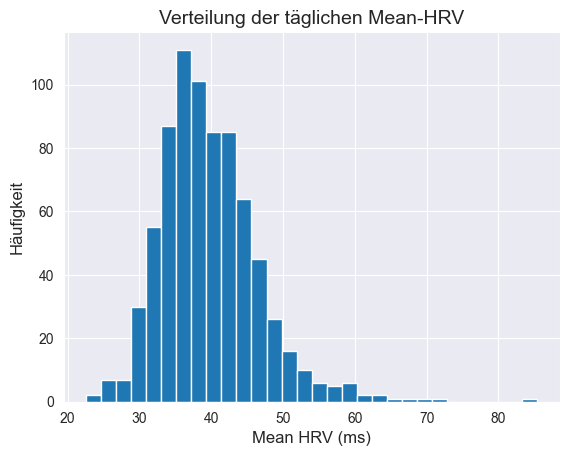

In [293]:
plt.hist(df_all["mean_hrv"], bins=30)
plt.title("Verteilung der täglichen Mean-HRV", fontsize=14)
plt.xlabel("Mean HRV (ms)", fontsize=12)
plt.ylabel("Häufigkeit", fontsize=12)
plt.show()

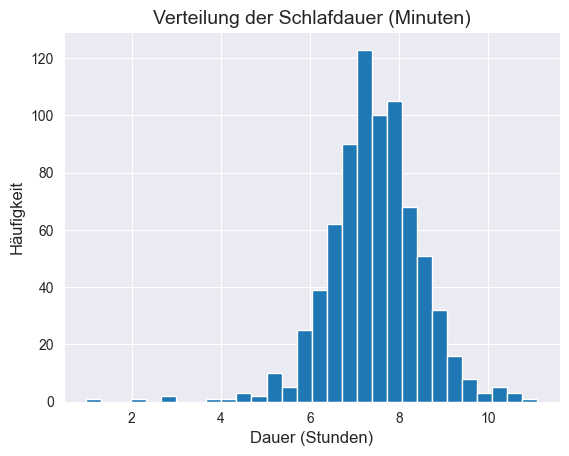

In [291]:
plt.hist(df_all["duration_min"] / 60, bins=30)
plt.title("Verteilung der Schlafdauer (Minuten)", fontsize=14)
plt.xlabel("Dauer (Stunden)", fontsize=12)
plt.ylabel("Häufigkeit", fontsize=12)
plt.show()

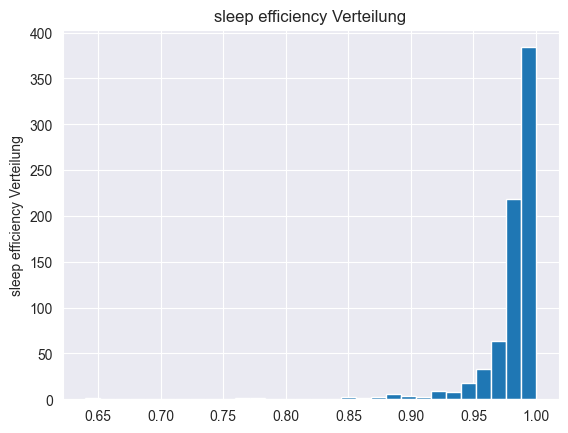

In [295]:
plt.hist(df_all["sleep_efficiency"],bins=30)
plt.title("sleep efficiency Verteilung")
plt.ylabel("sleep efficiency Verteilung")
plt.xlabel("sleep efficiency: ")
plt.show()
plt.show()

Text(0.5, 1.0, 'sleeo efficiency and hrv')

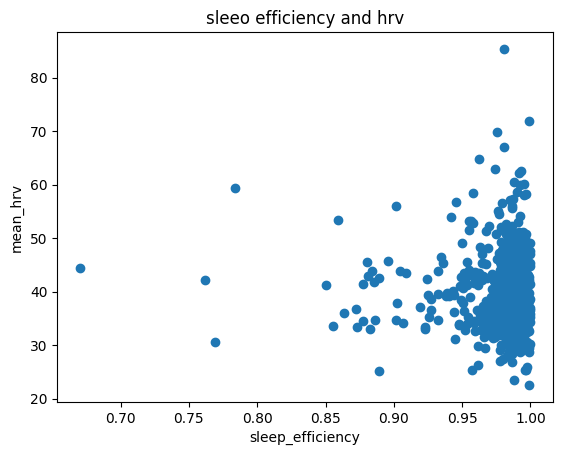

In [135]:
plt.scatter(df_all['sleep_efficiency'], df_all['mean_hrv'])
plt.xlabel("sleep_efficiency")
plt.ylabel("mean_hrv")
plt.title("sleeo efficiency and hrv")

Text(0.5, 1.0, 'Schlafdauer und HRV')

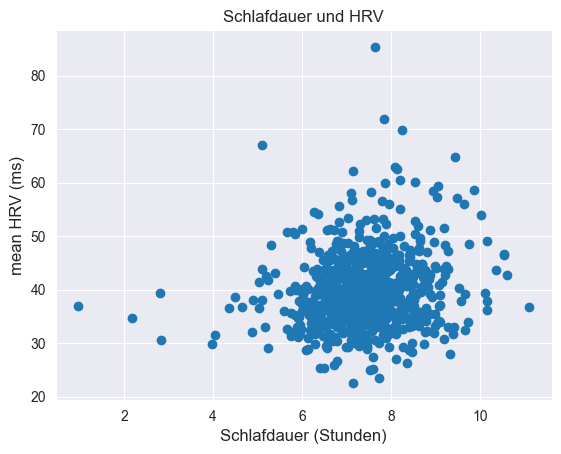

In [303]:
plt.scatter(df_all['duration_min'] / 60, df_all['mean_hrv'])
plt.xlabel("Schlafdauer (Stunden)", fontsize=12)
plt.ylabel("mean HRV (ms)", fontsize=12)
plt.title("Schlafdauer und HRV")

Text(0.5, 1.0, 'sleep duration and hrv')

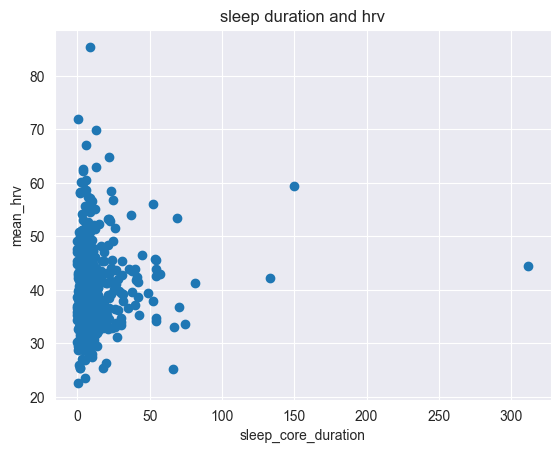

In [302]:
plt.scatter(df_all['Awake'] / pd.Timedelta(minutes=1), df_all['mean_hrv'])
plt.xlabel("sleep_core_duration")
plt.ylabel("mean_hrv")
plt.title("sleep duration and hrv")

## Seaborn: Statistical plots (Boxplot, Violin, Heatmap)

## Plotly: Create interactive visualizations

Idea:
+ Walking steps
+ Exercise duration
+ sleep pattern (start, end time)